# Load the relevant IMDb files and TMDB files, and conduct basic EDA and cleaning

In [1]:
### Import various packages

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
title_basics = pd.read_csv('title.basics.tsv',sep = '\t') 

/var/folders/sm/0dqpn8sx01v9pzyj0v4hn1sh0000gn/T/ipykernel_94054/895961172.py:1: DtypeWarning: Columns (4) have mixed types. Specify dtype option on import or set low_memory=False.
  title_basics = pd.read_csv('title.basics.tsv',sep = '\t')


In [3]:
## Get a general idea of what is in the dataset

title_basics.head

<bound method NDFrame.head of              tconst  titleType               primaryTitle  \
0         tt0000001      short                 Carmencita   
1         tt0000002      short     Le clown et ses chiens   
2         tt0000003      short             Pauvre Pierrot   
3         tt0000004      short                Un bon bock   
4         tt0000005      short           Blacksmith Scene   
...             ...        ...                        ...   
11042227  tt9916848  tvEpisode              Episode #3.17   
11042228  tt9916850  tvEpisode              Episode #3.19   
11042229  tt9916852  tvEpisode              Episode #3.20   
11042230  tt9916856      short                   The Wind   
11042231  tt9916880  tvEpisode  Horrid Henry Knows It All   

                      originalTitle isAdult startYear endYear runtimeMinutes  \
0                        Carmencita       0      1894      \N              1   
1            Le clown et ses chiens       0      1892      \N              5 

In [4]:
title_basics.columns

Index(['tconst', 'titleType', 'primaryTitle', 'originalTitle', 'isAdult',
       'startYear', 'endYear', 'runtimeMinutes', 'genres'],
      dtype='object')

In [5]:
title_basics.iloc[1:5]

,tconst,titleType,primaryTitle,originalTitle,isAdult,startYear,endYear,runtimeMinutes,genres
1,tt0000002,short,Le clown et ses chiens,Le clown et ses chiens,0,1892,\N,5,"Animation,Short"
2,tt0000003,short,Pauvre Pierrot,Pauvre Pierrot,0,1892,\N,5,"Animation,Comedy,Romance"
3,tt0000004,short,Un bon bock,Un bon bock,0,1892,\N,12,"Animation,Short"
4,tt0000005,short,Blacksmith Scene,Blacksmith Scene,0,1893,\N,1,"Comedy,Short"


In [6]:
## There are 269,209 tv series in the title_basics dataset. These titles will be used for this project.

title_basics['titleType'].value_counts()

titleType
tvEpisode       8466338
short           1014343
movie            690794
video            297294
tvSeries         269209
tvMovie          148610
tvMiniSeries      56381
tvSpecial         49162
videoGame         39708
tvShort           10392
tvPilot               1
Name: count, dtype: int64

In [7]:
## Assign the dataframe tv_basics to equal the filtered dataset of title_basics that only include tv series

tv_basics = title_basics[title_basics['titleType'] == 'tvSeries']
len(tv_basics)

269209

In [8]:
tv_basics.iloc[1:5]

,tconst,titleType,primaryTitle,originalTitle,isAdult,startYear,endYear,runtimeMinutes,genres
35170,tt0035803,tvSeries,The German Weekly Review,Die Deutsche Wochenschau,0,1940,1945,\N,"Documentary,News"
37598,tt0038276,tvSeries,You Are an Artist,You Are an Artist,0,1946,1955,15,Talk-Show
38432,tt0039120,tvSeries,Americana,Americana,0,1947,1949,30,"Family,Game-Show"
38433,tt0039121,tvSeries,Birthday Party,Birthday Party,0,1947,1949,30,Family


In [80]:
## Now, import a second dataset: title_ratings

title_ratings = pd.read_csv('title.ratings.tsv',sep = '\t') 

In [81]:
title_ratings

,tconst,averageRating,numVotes
0,tt0000001,5.7,2081
1,tt0000002,5.6,280
2,tt0000003,6.5,2078
3,tt0000004,5.4,181
4,tt0000005,6.2,2816
...,...,...,...
1472880,tt9916730,7.0,12
1472881,tt9916766,7.1,24
1472882,tt9916778,7.2,37
1472883,tt9916840,7.2,10


In [13]:
## Clean up tv_basics by replacing all '\N' values with "NaN"

tv_basics.replace("\\N", np.nan, inplace=True)

/var/folders/sm/0dqpn8sx01v9pzyj0v4hn1sh0000gn/T/ipykernel_94054/2205551014.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tv_basics.replace("\\N", np.nan, inplace=True)


In [14]:
## Now, drop the NaN values from the tv_basics dataset
tv_basics_cleaned = tv_basics.dropna()

In [15]:
tv_basics_cleaned

,tconst,titleType,primaryTitle,originalTitle,isAdult,startYear,endYear,runtimeMinutes,genres
37598,tt0038276,tvSeries,You Are an Artist,You Are an Artist,0,1946,1955,15,Talk-Show
38432,tt0039120,tvSeries,Americana,Americana,0,1947,1949,30,"Family,Game-Show"
38433,tt0039121,tvSeries,Birthday Party,Birthday Party,0,1947,1949,30,Family
38435,tt0039123,tvSeries,Kraft Theatre,Kraft Television Theatre,0,1947,1958,60,Drama
38437,tt0039125,tvSeries,Public Prosecutor,Public Prosecutor,0,1947,1951,20,"Crime,Drama,Mystery"
...,...,...,...,...,...,...,...,...,...
11041441,tt9915114,tvSeries,Touche pas à mon sport,Touche pas à mon sport,0,2015,2016,65,"Sport,Talk-Show"
11041450,tt9915138,tvSeries,Scandalous,Scandalous,0,2018,2019,60,"Crime,Documentary"
11041541,tt9915338,tvSeries,Aunty Donna: Camp Bush Camp!,Aunty Donna: Camp Bush Camp!,0,2018,2018,5,Comedy
11041747,tt9915822,tvSeries,Ichhapyaari Naagin,Ichhapyaari Naagin,0,2016,2020,20,Fantasy


In [83]:
## Remove duplicate or irrelevant columns 

tv_basics_short = tv_basics_cleaned[['tconst', 'primaryTitle', 'isAdult', 'endYear', 'runtimeMinutes', 'genres']]
tv_basics_short

,tconst,primaryTitle,isAdult,endYear,runtimeMinutes,genres
37598,tt0038276,You Are an Artist,0,1955,15,Talk-Show
38432,tt0039120,Americana,0,1949,30,"Family,Game-Show"
38433,tt0039121,Birthday Party,0,1949,30,Family
38435,tt0039123,Kraft Theatre,0,1958,60,Drama
38437,tt0039125,Public Prosecutor,0,1951,20,"Crime,Drama,Mystery"
...,...,...,...,...,...,...
11041441,tt9915114,Touche pas à mon sport,0,2016,65,"Sport,Talk-Show"
11041450,tt9915138,Scandalous,0,2019,60,"Crime,Documentary"
11041541,tt9915338,Aunty Donna: Camp Bush Camp!,0,2018,5,Comedy
11041747,tt9915822,Ichhapyaari Naagin,0,2020,20,Fantasy


In [84]:
## Repeat the previous few steps for the title_ratings dataset, starting with replacing \N values with NaN

title_ratings.replace("\\N", np.nan, inplace=True)

In [19]:
## Drop NaN values from title_ratings

title_ratings_cleaned = title_ratings.dropna()

In [20]:
title_ratings_cleaned

,tconst,averageRating,numVotes
0,tt0000001,5.7,2081
1,tt0000002,5.6,280
2,tt0000003,6.5,2078
3,tt0000004,5.4,181
4,tt0000005,6.2,2816
...,...,...,...
1472880,tt9916730,7.0,12
1472881,tt9916766,7.1,24
1472882,tt9916778,7.2,37
1472883,tt9916840,7.2,10


In [21]:
## Now, merge the two cleaned datasets: tv_basics and title_ratings_cleaned

tv_merged = pd.merge(tv_basics_short, title_ratings_cleaned, how="inner", left_on="tconst", right_on="tconst")

In [22]:
tv_merged

,tconst,primaryTitle,isAdult,endYear,runtimeMinutes,genres,averageRating,numVotes
0,tt0039120,Americana,0,1949,30,"Family,Game-Show",2.7,19
1,tt0039123,Kraft Theatre,0,1958,60,Drama,8.0,224
2,tt0039125,Public Prosecutor,0,1951,20,"Crime,Drama,Mystery",5.9,35
3,tt0040021,Actor's Studio,0,1950,30,Drama,6.9,93
4,tt0040028,Talent Scouts,0,1958,30,"Comedy,Family,Music",6.1,26
...,...,...,...,...,...,...,...,...
28540,tt9915022,Yarali Kuslar,0,2019,90,Drama,4.9,127
28541,tt9915138,Scandalous,0,2019,60,"Crime,Documentary",6.9,13
28542,tt9915338,Aunty Donna: Camp Bush Camp!,0,2018,5,Comedy,8.5,44
28543,tt9915822,Ichhapyaari Naagin,0,2020,20,Fantasy,7.9,74


## One-hot-encode required columns

In [23]:
## Get an idea of what the genres column looks like

tv_merged['genres'].value_counts()

genres
Comedy                           4032
Drama                            2726
Documentary                      1129
Action,Adventure,Animation        970
Drama,Romance                     898
                                 ... 
Action,Crime,History                1
Adventure,Animation,Music           1
Adventure,Animation,Biography       1
Documentary,Drama,Talk-Show         1
Adventure,Drama,Sport               1
Name: count, Length: 878, dtype: int64

In [24]:
## Split up the "genres" column into multiple genres and then do one-hot-encoding to create numerical columns
## for our upcoming predictive models.

tv_merged['genres_list'] = tv_merged['genres'].str.split(',')

# Create a one-hot encoding of the genres
tv_genre_enc = tv_merged['genres_list'].apply(lambda x: pd.Series(1, index=x)).fillna(0)

# Combine the original DataFrame with the new one-hot encoded genre columns
df_final = tv_merged.drop('genres_list', axis=1).join(tv_genre_enc)

# Display the resulting DataFrame
df_final

,tconst,primaryTitle,isAdult,endYear,runtimeMinutes,genres,averageRating,numVotes,Family,Game-Show,...,Thriller,Biography,Documentary,News,Fantasy,Musical,War,Sport,Short,Adult
0,tt0039120,Americana,0,1949,30,"Family,Game-Show",2.7,19,1.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,tt0039123,Kraft Theatre,0,1958,60,Drama,8.0,224,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,tt0039125,Public Prosecutor,0,1951,20,"Crime,Drama,Mystery",5.9,35,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,tt0040021,Actor's Studio,0,1950,30,Drama,6.9,93,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,tt0040028,Talent Scouts,0,1958,30,"Comedy,Family,Music",6.1,26,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28540,tt9915022,Yarali Kuslar,0,2019,90,Drama,4.9,127,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
28541,tt9915138,Scandalous,0,2019,60,"Crime,Documentary",6.9,13,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
28542,tt9915338,Aunty Donna: Camp Bush Camp!,0,2018,5,Comedy,8.5,44,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
28543,tt9915822,Ichhapyaari Naagin,0,2020,20,Fantasy,7.9,74,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0


In [25]:
## Now, drop the original "genres" column

df_final = df_final.drop('genres', axis=1)
df_final

,tconst,primaryTitle,isAdult,endYear,runtimeMinutes,averageRating,numVotes,Family,Game-Show,Drama,...,Thriller,Biography,Documentary,News,Fantasy,Musical,War,Sport,Short,Adult
0,tt0039120,Americana,0,1949,30,2.7,19,1.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,tt0039123,Kraft Theatre,0,1958,60,8.0,224,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,tt0039125,Public Prosecutor,0,1951,20,5.9,35,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,tt0040021,Actor's Studio,0,1950,30,6.9,93,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,tt0040028,Talent Scouts,0,1958,30,6.1,26,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28540,tt9915022,Yarali Kuslar,0,2019,90,4.9,127,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
28541,tt9915138,Scandalous,0,2019,60,6.9,13,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
28542,tt9915338,Aunty Donna: Camp Bush Camp!,0,2018,5,8.5,44,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
28543,tt9915822,Ichhapyaari Naagin,0,2020,20,7.9,74,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0


## Load in and merge more data to provide additional features for our predictive model

In [26]:
## Let's load in another dataset from TMDB in order to give us more columns in our dataset that can help us 
## recommend similar tv shows from a given tv show.

tmdb = pd.read_csv('TMDB_tv_dataset_v3.csv') 
tmdb

,id,name,number_of_seasons,number_of_episodes,original_language,vote_count,vote_average,overview,adult,backdrop_path,...,tagline,genres,created_by,languages,networks,origin_country,spoken_languages,production_companies,production_countries,episode_run_time
0,1399,Game of Thrones,8,73,en,21857,8.442,Seven noble families fight for control of the ...,False,/2OMB0ynKlyIenMJWI2Dy9IWT4c.jpg,...,Winter Is Coming,"Sci-Fi & Fantasy, Drama, Action & Adventure","David Benioff, D.B. Weiss",en,HBO,US,English,"Revolution Sun Studios, Television 360, Genera...","United Kingdom, United States of America",0
1,71446,Money Heist,3,41,es,17836,8.257,"To carry out the biggest heist in history, a m...",False,/gFZriCkpJYsApPZEF3jhxL4yLzG.jpg,...,The perfect robbery.,"Crime, Drama",Álex Pina,es,"Netflix, Antena 3",ES,Español,Vancouver Media,Spain,70
2,66732,Stranger Things,4,34,en,16161,8.624,"When a young boy vanishes, a small town uncove...",False,/2MaumbgBlW1NoPo3ZJO38A6v7OS.jpg,...,Every ending has a beginning.,"Drama, Sci-Fi & Fantasy, Mystery","Matt Duffer, Ross Duffer",en,Netflix,US,English,"21 Laps Entertainment, Monkey Massacre Product...",United States of America,0
3,1402,The Walking Dead,11,177,en,15432,8.121,Sheriff's deputy Rick Grimes awakens from a co...,False,/x4salpjB11umlUOltfNvSSrjSXm.jpg,...,Fight the dead. Fear the living.,"Action & Adventure, Drama, Sci-Fi & Fantasy",Frank Darabont,en,AMC,US,English,"AMC Studios, Circle of Confusion, Valhalla Mot...",United States of America,42
4,63174,Lucifer,6,93,en,13870,8.486,"Bored and unhappy as the Lord of Hell, Lucifer...",False,/aDBRtunw49UF4XmqfyNuD9nlYIu.jpg,...,It's good to be bad.,"Crime, Sci-Fi & Fantasy",Tom Kapinos,en,"FOX, Netflix",US,English,"Warner Bros. Television, DC Entertainment, Jer...",United States of America,45
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
168634,239099,母乳酱想要喷出来,1,1,zh,0,0.000,NaN,False,NaN,...,NaN,NaN,NaN,NaN,NaN,CN,NaN,NaN,NaN,0
168635,241205,Barbie Dream Squad,1,1,es,0,0.000,NaN,False,NaN,...,NaN,NaN,"Dee Shipley, Blair Davidson",NaN,NaN,US,NaN,NaN,NaN,0
168636,240696,Picasso,1,1,bn,0,0.000,"Murder, art and a journalist's relentless ques...",False,/fseBBbvHtdcZS5M7bSjOxYsVe5.jpg,...,NaN,Crime,NaN,bn,NaN,IN,বাংলা,NaN,India,0
168637,240697,女子大生危険なアルバイト,1,1,en,0,0.000,A college student gets into trouble when she m...,False,NaN,...,NaN,NaN,NaN,NaN,NaN,US,NaN,NaN,NaN,0


In [27]:
tmdb.columns

Index(['id', 'name', 'number_of_seasons', 'number_of_episodes',
       'original_language', 'vote_count', 'vote_average', 'overview', 'adult',
       'backdrop_path', 'first_air_date', 'last_air_date', 'homepage',
       'in_production', 'original_name', 'popularity', 'poster_path', 'type',
       'status', 'tagline', 'genres', 'created_by', 'languages', 'networks',
       'origin_country', 'spoken_languages', 'production_companies',
       'production_countries', 'episode_run_time'],
      dtype='object')

## Drop duplicate rows and irrelevant columns

In [28]:
## Does the id column of the tmdb dataset correspond to the tconst column of the df_final dataset? Answer: No

df_final[df_final['primaryTitle'] == 'Lucifer']

,tconst,primaryTitle,isAdult,endYear,runtimeMinutes,averageRating,numVotes,Family,Game-Show,Drama,...,Thriller,Biography,Documentary,News,Fantasy,Musical,War,Sport,Short,Adult
22794,tt4052886,Lucifer,0,2021,43,8.1,362524,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0


In [29]:
## Only keep the columns that may be relevant for predicting similar tv shows. Also, remove any columns that 
## may provide duplicate information to avoid multicollinearity.

tmdb_short = tmdb[['name', 'number_of_seasons', 'number_of_episodes', 'original_language', 'overview', 'first_air_date', 
                   'last_air_date', 'in_production', 'popularity', 'type', 'status', 'tagline', 'created_by', 'networks', 
                   'origin_country', 'production_companies', 'episode_run_time']]
tmdb_short

,name,number_of_seasons,number_of_episodes,original_language,overview,first_air_date,last_air_date,in_production,popularity,type,status,tagline,created_by,networks,origin_country,production_companies,episode_run_time
0,Game of Thrones,8,73,en,Seven noble families fight for control of the ...,2011-04-17,2019-05-19,False,1083.917,Scripted,Ended,Winter Is Coming,"David Benioff, D.B. Weiss",HBO,US,"Revolution Sun Studios, Television 360, Genera...",0
1,Money Heist,3,41,es,"To carry out the biggest heist in history, a m...",2017-05-02,2021-12-03,False,96.354,Scripted,Ended,The perfect robbery.,Álex Pina,"Netflix, Antena 3",ES,Vancouver Media,70
2,Stranger Things,4,34,en,"When a young boy vanishes, a small town uncove...",2016-07-15,2022-07-01,True,185.711,Scripted,Returning Series,Every ending has a beginning.,"Matt Duffer, Ross Duffer",Netflix,US,"21 Laps Entertainment, Monkey Massacre Product...",0
3,The Walking Dead,11,177,en,Sheriff's deputy Rick Grimes awakens from a co...,2010-10-31,2022-11-20,False,489.746,Scripted,Ended,Fight the dead. Fear the living.,Frank Darabont,AMC,US,"AMC Studios, Circle of Confusion, Valhalla Mot...",42
4,Lucifer,6,93,en,"Bored and unhappy as the Lord of Hell, Lucifer...",2016-01-25,2021-09-10,False,416.668,Scripted,Ended,It's good to be bad.,Tom Kapinos,"FOX, Netflix",US,"Warner Bros. Television, DC Entertainment, Jer...",45
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
168634,母乳酱想要喷出来,1,1,zh,NaN,2023-03-03,2023-03-03,True,1.400,Scripted,Returning Series,NaN,NaN,NaN,CN,NaN,0
168635,Barbie Dream Squad,1,1,es,NaN,NaN,2023-03-04,False,0.600,Scripted,Ended,NaN,"Dee Shipley, Blair Davidson",NaN,US,NaN,0
168636,Picasso,1,1,bn,"Murder, art and a journalist's relentless ques...",2023-11-30,2023-11-30,True,1.895,Scripted,Returning Series,NaN,NaN,NaN,IN,NaN,0
168637,女子大生危険なアルバイト,1,1,en,A college student gets into trouble when she m...,1990-02-10,1990-02-10,True,0.600,Scripted,Returning Series,NaN,NaN,NaN,US,NaN,0


In [30]:
## Now, merge the 2 IMDB datasets (already merged in df_final) with the tmdb_short dataset

imdb_tmdb = pd.merge(df_final,tmdb_short, how="inner", left_on="primaryTitle", right_on="name")
imdb_tmdb

,tconst,primaryTitle,isAdult,endYear,runtimeMinutes,averageRating,numVotes,Family,Game-Show,Drama,...,in_production,popularity,type,status,tagline,created_by,networks,origin_country,production_companies,episode_run_time
0,tt0039120,Americana,0,1949,30,2.7,19,1.0,1.0,0.0,...,False,0.841,Scripted,Ended,NaN,NaN,NBC,US,"NBC Productions, Martin Stone Productions",30
1,tt0039120,Americana,0,1949,30,2.7,19,1.0,1.0,0.0,...,True,1.567,Scripted,In Production,NaN,NaN,STAR+,BR,"Cinefilm*, Star Original Productions, Non Stop...",0
2,tt0039120,Americana,0,1949,30,2.7,19,1.0,1.0,0.0,...,False,0.840,Scripted,Ended,NaN,Jonathan Ross,NaN,GB,NaN,0
3,tt0039125,Public Prosecutor,0,1951,20,5.9,35,0.0,0.0,1.0,...,False,2.758,Scripted,Ended,NaN,NaN,TVP2,PL,ATM Grupa,43
4,tt0039125,Public Prosecutor,0,1951,20,5.9,35,0.0,0.0,1.0,...,False,1.651,Scripted,Ended,NaN,Lew Landers,DuMont Television Network,US,Jerry Fairbanks Productions,20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25829,tt9908414,Block 13,0,2003,10,3.8,437,0.0,0.0,1.0,...,True,0.600,Scripted,Returning Series,NaN,NaN,NaN,KW,NaN,0
25830,tt9910028,Sacch Ka Saamna,0,2012,25,6.9,11,0.0,0.0,0.0,...,False,0.600,Scripted,Ended,NaN,Howard Schultz,StarPlus,IO,NaN,0
25831,tt9910028,Sacch Ka Saamna,0,2012,25,6.9,11,0.0,0.0,0.0,...,False,0.600,Scripted,Ended,NaN,NaN,NaN,IO,NaN,0
25832,tt9910028,Sacch Ka Saamna,0,2012,25,6.9,11,0.0,0.0,0.0,...,False,0.600,Scripted,Ended,NaN,NaN,NaN,IO,NaN,0


In [31]:
## Drop NaN values from the imdb_tmdb dataset

merged_cleaned = imdb_tmdb.dropna()
merged_cleaned

,tconst,primaryTitle,isAdult,endYear,runtimeMinutes,averageRating,numVotes,Family,Game-Show,Drama,...,in_production,popularity,type,status,tagline,created_by,networks,origin_country,production_companies,episode_run_time
58,tt0041027,The Goldbergs,0,1957,30,7.5,216,0.0,0.0,0.0,...,False,64.057,Scripted,Ended,Picture perfect.,Adam F. Goldberg,ABC,US,"Sony Pictures Television Studios, DR Productio...",22
60,tt2712740,The Goldbergs,0,2023,22,8.0,41510,0.0,0.0,0.0,...,False,64.057,Scripted,Ended,Picture perfect.,Adam F. Goldberg,ABC,US,"Sony Pictures Television Studios, DR Productio...",22
105,tt0042094,The Colgate Comedy Hour,0,1955,60,7.7,598,0.0,0.0,0.0,...,False,137.251,Scripted,Ended,This was a Colgate-sponsored comedy hour that ...,Fred Hamilton,NBC,US,"Colgate-Palmolive-Peet, NBC",60
161,tt0043208,I Love Lucy,0,1957,30,8.5,29293,0.0,0.0,0.0,...,False,275.035,Scripted,Ended,Vitameatavegamin - Spoon Your Way To Health!,"Bob Carroll Jr., Madelyn Pugh, Jess Oppenheimer",CBS,US,Desilu Productions,30
177,tt0044229,The Abbott and Costello Show,0,1957,25,8.1,1381,1.0,0.0,0.0,...,False,109.441,Scripted,Ended,The comedic duo engages in humorous scenarios.,"Clyde Bruckman, Lou Costello, Jack Townley, Ed...",Syndication,US,Television Corporation of America,25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25783,tt9788012,Traces,0,2022,45,7.0,7033,0.0,0.0,0.0,...,False,8.080,Scripted,Ended,The evidence doesn't lie. People do.,"Amelia Bullmore, Val McDermid",Alibi,GB,Red Production Company,46
25784,tt9795876,Star Trek: Prodigy,0,2024,24,7.6,6755,0.0,0.0,0.0,...,False,63.347,Scripted,Canceled,Set phasers to fun.,"Dan Hageman, Kevin Hageman",Paramount+,US,"Roddenberry Entertainment, Secret Hideout, Bro...",25
25807,tt9856336,Aruanas,0,2021,60,6.8,276,0.0,0.0,1.0,...,True,3.280,Scripted,Returning Series,Care. Preserve. Resist. They are...,"Estela Renner, Marcos Nisti",Globoplay,BR,"Maria Farinha Filmes, Estúdios Globo",0
25812,tt9863724,Beautiful World,0,2019,60,8.0,219,0.0,0.0,1.0,...,False,5.324,Scripted,Ended,"I begged earnestly. May the son wake up, may t...",Park Jae-beom,JTBC,KR,SLL,60


In [32]:
## Check for duplicate columns

merged_cleaned.columns

Index(['tconst', 'primaryTitle', 'isAdult', 'endYear', 'runtimeMinutes',
       'averageRating', 'numVotes', 'Family', 'Game-Show', 'Drama', 'Crime',
       'Mystery', 'Comedy', 'Music', 'Talk-Show', 'Reality-TV', 'History',
       'Action', 'Adventure', 'Western', 'Horror', 'Sci-Fi', 'Romance',
       'Animation', 'Thriller', 'Biography', 'Documentary', 'News', 'Fantasy',
       'Musical', 'War', 'Sport', 'Short', 'Adult', 'name',
       'number_of_seasons', 'number_of_episodes', 'original_language',
       'overview', 'first_air_date', 'last_air_date', 'in_production',
       'popularity', 'type', 'status', 'tagline', 'created_by', 'networks',
       'origin_country', 'production_companies', 'episode_run_time'],
      dtype='object')

In [33]:
## Duplicate columns identified: tconst, endYear, name

merged_shorter = merged_cleaned.drop(['tconst', 'endYear', 'name'], axis=1)
merged_shorter.columns

Index(['primaryTitle', 'isAdult', 'runtimeMinutes', 'averageRating',
       'numVotes', 'Family', 'Game-Show', 'Drama', 'Crime', 'Mystery',
       'Comedy', 'Music', 'Talk-Show', 'Reality-TV', 'History', 'Action',
       'Adventure', 'Western', 'Horror', 'Sci-Fi', 'Romance', 'Animation',
       'Thriller', 'Biography', 'Documentary', 'News', 'Fantasy', 'Musical',
       'War', 'Sport', 'Short', 'Adult', 'number_of_seasons',
       'number_of_episodes', 'original_language', 'overview', 'first_air_date',
       'last_air_date', 'in_production', 'popularity', 'type', 'status',
       'tagline', 'created_by', 'networks', 'origin_country',
       'production_companies', 'episode_run_time'],
      dtype='object')

In [34]:
## Double check if there are multiple rows with the same primaryTitle

merged_shorter['primaryTitle'].value_counts()

primaryTitle
The Twilight Zone         12
The Family                10
Utopia                     6
Mr. Sunshine               6
Dynasty                    6
                          ..
Ultraman Z                 1
Out of Her Mind            1
The Mentalist              1
Minx                       1
Motherland: Fort Salem     1
Name: count, Length: 1369, dtype: int64

In [35]:
## See what some observations look like that have the same primaryTitle

merged_shorter[merged_shorter['primaryTitle'] == 'The Twilight Zone']

,primaryTitle,isAdult,runtimeMinutes,averageRating,numVotes,Family,Game-Show,Drama,Crime,Mystery,...,in_production,popularity,type,status,tagline,created_by,networks,origin_country,production_companies,episode_run_time
892,The Twilight Zone,0,50,9.1,95453,0.0,0.0,1.0,0.0,0.0,...,False,344.834,Scripted,Ended,You are about to enter another dimension.,Rod Serling,CBS,US,"CBS Productions, Cayuga Productions",30
893,The Twilight Zone,0,50,9.1,95453,0.0,0.0,1.0,0.0,0.0,...,False,27.561,Scripted,Canceled,What dimension are you even in?,"Simon Kinberg, Rod Serling, Jordan Peele, Marc...",CBS All Access,US,"Genre Films, Monkeypaw Productions",55
895,The Twilight Zone,0,50,9.1,95453,0.0,0.0,1.0,0.0,0.0,...,False,148.000,Scripted,Canceled,Check your reality at the door.,Rod Serling,UPN,US,"Trilogy Entertainment Group, New Line Televisi...",21
896,The Twilight Zone,0,45,7.7,12437,0.0,0.0,1.0,0.0,0.0,...,False,344.834,Scripted,Ended,You are about to enter another dimension.,Rod Serling,CBS,US,"CBS Productions, Cayuga Productions",30
897,The Twilight Zone,0,45,7.7,12437,0.0,0.0,1.0,0.0,0.0,...,False,27.561,Scripted,Canceled,What dimension are you even in?,"Simon Kinberg, Rod Serling, Jordan Peele, Marc...",CBS All Access,US,"Genre Films, Monkeypaw Productions",55
899,The Twilight Zone,0,45,7.7,12437,0.0,0.0,1.0,0.0,0.0,...,False,148.000,Scripted,Canceled,Check your reality at the door.,Rod Serling,UPN,US,"Trilogy Entertainment Group, New Line Televisi...",21
900,The Twilight Zone,0,43,7.2,6751,0.0,0.0,1.0,0.0,0.0,...,False,344.834,Scripted,Ended,You are about to enter another dimension.,Rod Serling,CBS,US,"CBS Productions, Cayuga Productions",30
901,The Twilight Zone,0,43,7.2,6751,0.0,0.0,1.0,0.0,0.0,...,False,27.561,Scripted,Canceled,What dimension are you even in?,"Simon Kinberg, Rod Serling, Jordan Peele, Marc...",CBS All Access,US,"Genre Films, Monkeypaw Productions",55
903,The Twilight Zone,0,43,7.2,6751,0.0,0.0,1.0,0.0,0.0,...,False,148.000,Scripted,Canceled,Check your reality at the door.,Rod Serling,UPN,US,"Trilogy Entertainment Group, New Line Televisi...",21
904,The Twilight Zone,0,60,6.0,18625,0.0,0.0,1.0,0.0,0.0,...,False,344.834,Scripted,Ended,You are about to enter another dimension.,Rod Serling,CBS,US,"CBS Productions, Cayuga Productions",30


In [87]:
## Remove any columns with the same "primaryTitle" column, only keeping the first title

merged_unique = merged_shorter.drop_duplicates(subset='primaryTitle', keep='first')

## Create dummy columns for the merged dataset

In [39]:
## Create dummy columns to ensure all columns are quantitative (aside from primaryTitle)
### Find which columns need to be dummified

pd.set_option('display.max_columns', None)
merged_unique.head()

,primaryTitle,isAdult,runtimeMinutes,averageRating,numVotes,Family,Game-Show,Drama,Crime,Mystery,Comedy,Music,Talk-Show,Reality-TV,History,Action,Adventure,Western,Horror,Sci-Fi,Romance,Animation,Thriller,Biography,Documentary,News,Fantasy,Musical,War,Sport,Short,Adult,number_of_seasons,number_of_episodes,original_language,overview,first_air_date,last_air_date,in_production,popularity,type,status,tagline,created_by,networks,origin_country,production_companies,episode_run_time
58,The Goldbergs,0,30,7.5,216,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10,229,en,"Before there were parenting blogs, trophies fo...",2013-09-24,2023-05-03,False,64.057,Scripted,Ended,Picture perfect.,Adam F. Goldberg,ABC,US,"Sony Pictures Television Studios, DR Productio...",22
105,The Colgate Comedy Hour,0,60,7.7,598,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6,206,en,The Colgate Comedy Hour is an American comedy-...,1950-09-10,1955-12-25,False,137.251,Scripted,Ended,This was a Colgate-sponsored comedy hour that ...,Fred Hamilton,NBC,US,"Colgate-Palmolive-Peet, NBC",60
161,I Love Lucy,0,30,8.5,29293,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6,180,en,Cuban Bandleader Ricky Ricardo would be happy ...,1951-10-15,1957-05-06,False,275.035,Scripted,Ended,Vitameatavegamin - Spoon Your Way To Health!,"Bob Carroll Jr., Madelyn Pugh, Jess Oppenheimer",CBS,US,Desilu Productions,30
177,The Abbott and Costello Show,0,25,8.1,1381,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2,52,en,Bud and Lou are unemployed actors living in Mr...,1952-12-05,1954-05-01,False,109.441,Scripted,Ended,The comedic duo engages in humorous scenarios.,"Clyde Bruckman, Lou Costello, Jack Townley, Ed...",Syndication,US,Television Corporation of America,25
179,Adventures of Superman,0,30,7.7,4564,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6,104,en,"Announcer: ""The Adventures of Superman. Faste...",1952-09-19,1958-04-28,False,56.203,Scripted,Ended,It's a bird! It's a plane! It's Superman!,"Robert Maxwell, Whitney Ellsworth","ABC, Syndication",US,"DC Comics, Motion Pictures for Television, War...",25


In [40]:
## Columns to be dummified: original_language, in_production, type, status, networks, origin_country

## Columns to be first split into a list and then dummified: overview, tagline, created_by (by ", "), 
## production_companies (by ", "), networks (by ", "), origin_country (by ", ")

In [41]:
## Get dummy columns for the columns 'original_language', 'in_production', 'type', and 'status'

merged_dummified = pd.get_dummies(merged_unique, columns=['original_language', 'in_production', 'type', 'status'])
merged_dummified

,primaryTitle,isAdult,runtimeMinutes,averageRating,numVotes,Family,Game-Show,Drama,Crime,Mystery,Comedy,Music,Talk-Show,Reality-TV,History,Action,Adventure,Western,Horror,Sci-Fi,Romance,Animation,Thriller,Biography,Documentary,News,Fantasy,Musical,War,Sport,Short,Adult,number_of_seasons,number_of_episodes,overview,first_air_date,last_air_date,popularity,tagline,created_by,networks,origin_country,production_companies,episode_run_time,original_language_ar,original_language_bg,original_language_da,original_language_de,original_language_el,original_language_en,original_language_es,original_language_fa,original_language_fi,original_language_fr,original_language_ga,original_language_hi,original_language_hr,original_language_it,original_language_ja,original_language_ko,original_language_mr,original_language_ms,original_language_nl,original_language_no,original_language_pl,original_language_pt,original_language_ro,original_language_ru,original_language_sk,original_language_sr,original_language_sv,original_language_th,original_language_tl,original_language_zh,in_production_False,in_production_True,type_Documentary,type_Miniseries,type_Reality,type_Scripted,type_Talk Show,type_Video,status_Canceled,status_Ended,status_Returning Series
58,The Goldbergs,0,30,7.5,216,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10,229,"Before there were parenting blogs, trophies fo...",2013-09-24,2023-05-03,64.057,Picture perfect.,Adam F. Goldberg,ABC,US,"Sony Pictures Television Studios, DR Productio...",22,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False,False,False,True,False
105,The Colgate Comedy Hour,0,60,7.7,598,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6,206,The Colgate Comedy Hour is an American comedy-...,1950-09-10,1955-12-25,137.251,This was a Colgate-sponsored comedy hour that ...,Fred Hamilton,NBC,US,"Colgate-Palmolive-Peet, NBC",60,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False,False,False,True,False
161,I Love Lucy,0,30,8.5,29293,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6,180,Cuban Bandleader Ricky Ricardo would be happy ...,1951-10-15,1957-05-06,275.035,Vitameatavegamin - Spoon Your Way To Health!,"Bob Carroll Jr., Madelyn Pugh, Jess Oppenheimer",CBS,US,Desilu Productions,30,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False,False,False,True,False
177,The Abbott and Costello Show,0,25,8.1,1381,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2,52,Bud and Lou are unemployed actors living in Mr...,1952-12-05,1954-05-01,109.441,The comedic duo engages in humorous scenarios.,"Clyde Bruckman, Lou Costello, Jack Townley, Ed...",Syndication,US,Television Corporation of America,25,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False,False,False,True,False
179,Adventures of Superman,0,30,7.7,4564,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6,104,"Announcer: ""The Adventures of Superman. Faste...",1952-09-19,1958-04-28,56.203,It's a bird! It's a plane! It's Superman!,"Robert Maxwell, Whitney Ellsworth","ABC, Syndication",US,"DC Comics, Motion Pictures for Television, War...

In [43]:
## Split into multiple words then dummify for the columns "created_by", "production_companies" and "origin_country"
## (dropping networks for simplification because many overlap with production companies)

merged_dummified['created_by_list'] = merged_dummified['created_by'].str.split(',')

created_by_enc = merged_dummified['created_by_list'].apply(lambda x: pd.Series(1, index=x)).fillna(0)

merged_dummified_1 = merged_dummified.drop('created_by_list', axis=1).join(created_by_enc)


merged_dummified_1['production_comp_list'] = merged_dummified_1['production_companies'].str.split(',')

production_comp_enc = merged_dummified_1['production_comp_list'].apply(lambda x: pd.Series(1, index=x)).fillna(0)

production_comp_enc = production_comp_enc.drop('Carter Bays', axis=1)

merged_dummified_2 = merged_dummified_1.drop('production_comp_list', axis=1).join(production_comp_enc)


merged_dummified_2['origin_country_list'] = merged_dummified_2['origin_country'].str.split(',')

origin_country_enc = merged_dummified_2['origin_country_list'].apply(lambda x: pd.Series(1, index=x)).fillna(0)

merged_dummified_3 = merged_dummified_2.drop(['origin_country_list'], axis=1).join(origin_country_enc)


merged_dummified_3 = merged_dummified_3.drop(['created_by', 'production_companies', 'origin_country', 'networks'], axis=1)

merged_dummified_3

primaryTitle isAdult runtimeMinutes  averageRating  \
58                    The Goldbergs       0             30            7.5   
105         The Colgate Comedy Hour       0             60            7.7   
161                     I Love Lucy       0             30            8.5   
177    The Abbott and Costello Show       0             25            8.1   
179          Adventures of Superman       0             30            7.7   
...                             ...     ...            ...            ...   
25783                        Traces       0             45            7.0   
25784            Star Trek: Prodigy       0             24            7.6   
25807                       Aruanas       0             60            6.8   
25812               Beautiful World       0             60            8.0   
25826        Motherland: Fort Salem       0             42            7.3   

       numVotes  Family  Game-Show  Drama  Crime  Mystery  Comedy  Music  \
58          216     0.0        0.0    0.0    0.0      0.0     1.0    0.0   
105         598     0.0        0.0    0.0    0.0      0.0     1.0    0.0   
161       29293     0.0        0.0    0.0    0.0      0.0     1.0    0.0   
177        1381     1.0        0.0    0.0    0.0      1.0     1.0    0.0   
179        4564     0.0        0.0    0.0    1.0      0.0     0.0    0.0   
...         ...     ...        ...    ...    ...      ...     ...    ...   
25783      7033     0.0        0.0    0.0    1.0      1.0     0.0    0.0   
25784      6755     0.0        0.0    0.0    0.0      0.0     0.0    0.0   
25807       276     0.0        0.0    1.0    1.0      0.0     0.0    0.0   
25812       219     0.0        0.0    1.0    0.0      1.0     0.0    0.0   
25826     19028     0.0        0.0    1.0    0.0      0.0     0.0    0.0   

       Talk-Show  Reality-TV  History  Action  Adventure  Western  Horror  \
58           0.0         0.0      0.0     0.0        0.0      0.0     0.0   
105          0.0         0.0      0.0     0.0        0.0      0.0     0.0   
161          0.0         0.0      0.0     0.0        0.0      0.0     0.0   
177          0.0         0.0      0.0     0.0        0.0      0.0     0.0   
179          0.0         0.0      0.0     1.0        1.0      0.0     0.0   
...          ...         ...      ...     ...        ...      ...     ...   
25783        0.0         0.0      0.0     0.0        0.0      0.0     0.0   
25784        0.0         0.0      0.0     1.0        1.0      0.0     0.0   
25807        0.0         0.0      0.0     1.0        0.0      0.0     0.0   
25812        0.0         0.0      0.0     0.0        0.0      0.0     0.0   
25826        0.0         0.0      0.0     0.0        0.0      0.0     0.0   

       Sci-Fi  Romance  Animation  Thriller  Biography  Documentary  News  \
58        0.0      0.0        0.0       0.0        0.0          0.0   0.0   
105       0.0      1.0        0.0       0.0        0.0          0.0   0.0   
161       0.0      0.0        0.0       0.0        0.0          0.0   0.0   
177       0.0      0.0        0.0       0.0        0.0          0.0   0.0   
179       0.0      0.0        0.0       0.0        0.0          0.0   0.0   
...       ...      ...        ...       ...        ...          ...   ...   
25783     0.0      0.0        0.0       1.0        0.0          0.0   0.0   
25784     0.0      0.0        1.0       0.0        0.0          0.0   0.0   
25807     0.0      0.0        0.0       0.0        0.0          0.0   0.0   
25812     0.0      0.0        0.0       0.0        0.0          0.0   0.0   
25826     1.0      0.0        0.0       0.0        0.0          0.0   0.0   

       Fantasy  Musical  War  Sport  Short  Adult  number_of_seasons  \
58         0.0      0.0  0.0    0.0    0.0    0.0                 10   
105        0.0      0.0  0.0    0.0    0.0    0.0                  6   
161        0.0      0.0  0.0    0.0    0.0    0.0                  6   
177        0.0      0.0  0.0    0.0    0.0    0

In [44]:
## Now let's separate each word from the "overview" column of the dataframe and then one-hot-encode this column.
## We'll skip doing the same for the "tagline" column because there will be too much overlap, and instead we'll 
## just drop the tagline column.

merged_dummified_3['cleaned_overview'] = merged_dummified_3['overview'].str.replace(r'[^\w\s]', '', regex=True)
merged_dummified_3['cleaned_overview_list'] = merged_dummified_3['cleaned_overview'].str.split(' ')
overview_enc = merged_dummified_3['cleaned_overview_list'].apply(lambda x: pd.Series(1, index=pd.unique(x))).fillna(0)
overview_enc = overview_enc.drop(['Family', 'Drama', 'Crime', 'Mystery', 'Comedy', 'Western', 'Romance',
       'Fantasy', 'Musical', 'War', 'Short', 'Adult', 'popularity', 'networks',
       'ITV', 'WQED', 'BBC', 'Wellsville', 'HBO', 'CBC', 'Televisa', 'own',
       'Yellow', 'US', 'CA', 'IT'], axis=1)
merged_dummified_4 = merged_dummified_3.drop(['cleaned_overview_list'], axis=1).join(overview_enc)
merged_dummified_all = merged_dummified_4.drop(['cleaned_overview', 'overview', 'tagline'], axis=1)
merged_dummified_all

,primaryTitle,isAdult,runtimeMinutes,averageRating,numVotes,Family,Game-Show,Drama,Crime,Mystery,Comedy,Music,Talk-Show,Reality-TV,History,Action,Adventure,Western,Horror,Sci-Fi,Romance,Animation,Thriller,Biography,Documentary,News,Fantasy,Musical,War,Sport,Short,Adult,number_of_seasons,number_of_episodes,first_air_date,last_air_date,popularity,episode_run_time,original_language_ar,original_language_bg,original_language_da,original_language_de,original_language_el,original_language_en,original_language_es,original_language_fa,original_language_fi,original_language_fr,original_language_ga,original_language_hi,original_language_hr,original_language_it,original_language_ja,original_language_ko,original_language_mr,original_language_ms,original_language_nl,original_language_no,original_language_pl,original_language_pt,original_language_ro,original_language_ru,original_language_sk,original_language_sr,original_language_sv,original_language_th,original_language_tl,original_language_zh,in_production_False,in_production_True,type_Documentary,type_Miniseries,type_Reality,type_Scripted,type_Talk Show,type_Video,status_Canceled,status_Ended,status_Returning Series,Adam F. Goldberg,Fred Hamilton,Bob Carroll Jr.,Madelyn Pugh,Jess Oppenheimer,Clyde Bruckman,Lou Costello,Jack Townley,Eddie Forman,Sid Fields,Robert Maxwell,Whitney Ellsworth,Irna Phillips,John Hawkesworth,John Meston,Rolin Jones,Ron Fitzgerald,Erle Stanley Gardner,Rob Williams,Stirling Silliphant,Blake Edwards,Ed Whitmore,Colin Sutton,Rod Serling,Simon Kinberg,Rod Serling,Jordan Peele,Marco Ramirez,Sheldon Leonard,Danny Thomas,Joss Whedon,David Greenwalt,Ralph Smart,Joseph Barbera,William Hanna,Herbert B. Leonard,Jason Shuman,Austin Winsberg,Eduardo Cisneros,Sydney Newman,Lee Daniels,Danny Strong,Aguinaldo Silva,Bob Weiskopf,Bob Schiller,Donald Wilson,C. E. Webber,Charles Addams,Sol Saks,Sylvia Anderson,Gerry Anderson,Buck Henry,Mel Brooks,Sidney Sheldon,Irwin Allen,Eiji Tsuburaya,William Dozier,Lorenzo Semple Jr.,Bruce Geller,Bert Schneider,Bob Rafelson,Gene Roddenberry,Collier Young,Michael Caleo,Patrick McGoohan,George Markstein,Leonard Freeman,Daniel Goldfarb,Fred Rogers,Richard Price,Ian MacNaughton,John Howard Davies,James L. Brooks,Allan Burns,Herman Miller,Johnny Speight,Norman Lear,Edward Hume,Frank Pierson,Jean Marsh,Eileen Atkins,John Hawkesworth,Jack Webb,Harold Jack Bloom,Robert A. Cinader,Christina M. Kim,Harry Driver,Vince Powell,Larry Gelbart,Earl Hamner,Jr.,Roy Clarke,Greg Berlanti,Phil Klemmer,Julie Plec,George Cheetham,Howard Rodman,Jeff Rice,Ed Friendly,Laura Ingalls Wilder,Phillip D'Antoni,Barry J. Weitz,Roy Huggins,Stephen J. Cannell,Jonathan Levine,Adam Reed,John Cleese,Connie Booth,Marc Richards,Aaron Rahsaan Thomas,Shawn Ryan,Terry Nation,Nick Willing,Joe Brumm,Ivan Goff,Ben Roberts,Roddy Doyle,Peter Paige,Bradley Bredeweg,Gail Parent,Ann Marcus,Jerry Adelman,Daniel Gregory Browne,Jim Henson,David E. Kelley,Sean Foley,Bertram van Munster,Elise Doganieri,Stanley Ralph Ross,Debbie Horsfield,Winston Graham,Susan Harris,Glen A. Larson,Gene Levitt,Kenneth Johnson,Stan Daniels,Ed. Weinberger,Hugh Wilson,Bruce Paltrow,Jon Robin Baitz,Marta Kauffman,David Crane,Verity Lambert,Leon Griffiths,Sallie Patrick,Stephanie Savage,Josh Schwartz,Esther Shapiro,Richard Alan Shapiro,Steven Bochco,Justin Adler,Maggie Mull,John Sullivan,Peyo,Jo Inglott,Glen Charles,Les Charles,James Burrows,Tate Taylor,Jerry Zucker,Jim Abrahams,David Zucker,Robert Butler,Michael Gleason,Joshua Brand,John Masius,John Falsey,Mark Tinker,Stephen J. Cannell,Frank Lupo,Richard Curtis,Rowan Atkinson,Ben Elton,Jay Tarses,Pavel G. Vesnakov,Ramón Campos,Gema R. Neira,Teresa Fernández-Valdés,Cecily Truett Lancit,Larry Lancit,Doru Năstase,Donald P. Bellisario,Краси Ванков,Anthony Yerkovich,Reinhold Weege,Scott Peters,Stan Brodsky,Steven Spielberg,Edward Kitsis,Adam Horowitz,Peter M. Lenkov,Lee David Zlotoff,Glenn Gordon Caron,Tom Patchett,Paul Fusco,Gustave Reininger,Chuck Adamson,Linda Bloodworth-Tho

In [45]:
## Now, let's create a single index that will take into account both the averageRating and numVotes from IMDB. 
## We can use this method: weighted rating (WR) = (v ÷ (v+3,000)) × R + (3,000 ÷ (v+3,000)) × 6.9

merged_dummified_all['weightedRating'] = (merged_dummified_all['numVotes'] / (merged_dummified_all['numVotes'] + 3000)) * merged_dummified_all['averageRating'] + (3000 / (merged_dummified_all['numVotes'] + 3000)) * 6.9

merged_dummified_clean = merged_dummified_all.drop(['numVotes', 'averageRating'], axis=1)
merged_dummified_clean

,primaryTitle,isAdult,runtimeMinutes,Family,Game-Show,Drama,Crime,Mystery,Comedy,Music,Talk-Show,Reality-TV,History,Action,Adventure,Western,Horror,Sci-Fi,Romance,Animation,Thriller,Biography,Documentary,News,Fantasy,Musical,War,Sport,Short,Adult,number_of_seasons,number_of_episodes,first_air_date,last_air_date,popularity,episode_run_time,original_language_ar,original_language_bg,original_language_da,original_language_de,original_language_el,original_language_en,original_language_es,original_language_fa,original_language_fi,original_language_fr,original_language_ga,original_language_hi,original_language_hr,original_language_it,original_language_ja,original_language_ko,original_language_mr,original_language_ms,original_language_nl,original_language_no,original_language_pl,original_language_pt,original_language_ro,original_language_ru,original_language_sk,original_language_sr,original_language_sv,original_language_th,original_language_tl,original_language_zh,in_production_False,in_production_True,type_Documentary,type_Miniseries,type_Reality,type_Scripted,type_Talk Show,type_Video,status_Canceled,status_Ended,status_Returning Series,Adam F. Goldberg,Fred Hamilton,Bob Carroll Jr.,Madelyn Pugh,Jess Oppenheimer,Clyde Bruckman,Lou Costello,Jack Townley,Eddie Forman,Sid Fields,Robert Maxwell,Whitney Ellsworth,Irna Phillips,John Hawkesworth,John Meston,Rolin Jones,Ron Fitzgerald,Erle Stanley Gardner,Rob Williams,Stirling Silliphant,Blake Edwards,Ed Whitmore,Colin Sutton,Rod Serling,Simon Kinberg,Rod Serling,Jordan Peele,Marco Ramirez,Sheldon Leonard,Danny Thomas,Joss Whedon,David Greenwalt,Ralph Smart,Joseph Barbera,William Hanna,Herbert B. Leonard,Jason Shuman,Austin Winsberg,Eduardo Cisneros,Sydney Newman,Lee Daniels,Danny Strong,Aguinaldo Silva,Bob Weiskopf,Bob Schiller,Donald Wilson,C. E. Webber,Charles Addams,Sol Saks,Sylvia Anderson,Gerry Anderson,Buck Henry,Mel Brooks,Sidney Sheldon,Irwin Allen,Eiji Tsuburaya,William Dozier,Lorenzo Semple Jr.,Bruce Geller,Bert Schneider,Bob Rafelson,Gene Roddenberry,Collier Young,Michael Caleo,Patrick McGoohan,George Markstein,Leonard Freeman,Daniel Goldfarb,Fred Rogers,Richard Price,Ian MacNaughton,John Howard Davies,James L. Brooks,Allan Burns,Herman Miller,Johnny Speight,Norman Lear,Edward Hume,Frank Pierson,Jean Marsh,Eileen Atkins,John Hawkesworth,Jack Webb,Harold Jack Bloom,Robert A. Cinader,Christina M. Kim,Harry Driver,Vince Powell,Larry Gelbart,Earl Hamner,Jr.,Roy Clarke,Greg Berlanti,Phil Klemmer,Julie Plec,George Cheetham,Howard Rodman,Jeff Rice,Ed Friendly,Laura Ingalls Wilder,Phillip D'Antoni,Barry J. Weitz,Roy Huggins,Stephen J. Cannell,Jonathan Levine,Adam Reed,John Cleese,Connie Booth,Marc Richards,Aaron Rahsaan Thomas,Shawn Ryan,Terry Nation,Nick Willing,Joe Brumm,Ivan Goff,Ben Roberts,Roddy Doyle,Peter Paige,Bradley Bredeweg,Gail Parent,Ann Marcus,Jerry Adelman,Daniel Gregory Browne,Jim Henson,David E. Kelley,Sean Foley,Bertram van Munster,Elise Doganieri,Stanley Ralph Ross,Debbie Horsfield,Winston Graham,Susan Harris,Glen A. Larson,Gene Levitt,Kenneth Johnson,Stan Daniels,Ed. Weinberger,Hugh Wilson,Bruce Paltrow,Jon Robin Baitz,Marta Kauffman,David Crane,Verity Lambert,Leon Griffiths,Sallie Patrick,Stephanie Savage,Josh Schwartz,Esther Shapiro,Richard Alan Shapiro,Steven Bochco,Justin Adler,Maggie Mull,John Sullivan,Peyo,Jo Inglott,Glen Charles,Les Charles,James Burrows,Tate Taylor,Jerry Zucker,Jim Abrahams,David Zucker,Robert Butler,Michael Gleason,Joshua Brand,John Masius,John Falsey,Mark Tinker,Stephen J. Cannell,Frank Lupo,Richard Curtis,Rowan Atkinson,Ben Elton,Jay Tarses,Pavel G. Vesnakov,Ramón Campos,Gema R. Neira,Teresa Fernández-Valdés,Cecily Truett Lancit,Larry Lancit,Doru Năstase,Donald P. Bellisario,Краси Ванков,Anthony Yerkovich,Reinhold Weege,Scott Peters,Stan Brodsky,Steven Spielberg,Edward Kitsis,Adam Horowitz,Peter M. Lenkov,Lee David Zlotoff,Glenn Gordon Caron,Tom Patchett,Paul Fusco,Gustave Reininger,Chuck Adamson,Linda Bloodworth-Thomason,Michael Elias,Ric

In [46]:
## Let's double check what the type is of the column "first_air_date" and "last_air_date"
## Turns out it's a string. We'll need to change that

type(merged_dummified_clean.loc[58, 'first_air_date'])

str

In [47]:
## Change the type of "first_air_date" and "last_air_date" to the Timestamp format

merged_dummified_clean['first_air_date'] = pd.to_datetime(merged_dummified_clean['first_air_date'], format='%Y-%m-%d')
print(type(merged_dummified_clean.loc[58, 'first_air_date']))

merged_dummified_clean['last_air_date'] = pd.to_datetime(merged_dummified_clean['last_air_date'], format='%Y-%m-%d')
print(type(merged_dummified_clean.loc[58, 'last_air_date']))

<class 'pandas._libs.tslibs.timestamps.Timestamp'>
<class 'pandas._libs.tslibs.timestamps.Timestamp'>


## Standardize required columns

In [48]:
## Now let's standardize the following columns to avoid bias when applying our ML algorithms.
## Here are the columns requiring standardizing: runtimeMinutes, number_of_seasons, number_of_episodes, popularity, 
## episode_run_time

from sklearn.preprocessing import StandardScaler

for column in ['runtimeMinutes', 'number_of_seasons', 'number_of_episodes', 'popularity', 'episode_run_time']:
    merged_dummified_clean[column] = merged_dummified_clean[column].astype(float)
    
    # Standardize the column
    scaler = StandardScaler()
    merged_dummified_clean[column] = scaler.fit_transform(merged_dummified_clean[[column]])

print(np.mean(merged_dummified_clean['runtimeMinutes']))
print(np.std(merged_dummified_clean['runtimeMinutes']))

print(np.mean(merged_dummified_clean['popularity']))
print(np.std(merged_dummified_clean['popularity']))

-1.0157866129522519e-17
0.9999999999999958
-5.0789330647612595e-18
0.9999999999999999


In [49]:
## We also need to standardize the first_air_date and last_air_date columns.

print(min(merged_dummified_clean['first_air_date']))
print(max(merged_dummified_clean['first_air_date']))

1950-09-10 00:00:00
2023-10-02 00:00:00


In [50]:
## Standardize the "first_air_date" and "last_air_date" columns

# Convert to a Unix timestamp
merged_dummified_clean['unix_first_air_date'] = merged_dummified_clean['first_air_date'].apply(lambda x: x.timestamp())

# Now standardize
scaler = StandardScaler()
merged_dummified_clean['standard_first_air_date'] = scaler.fit_transform(merged_dummified_clean[['unix_first_air_date']])

# Convert to a Unix timestamp
merged_dummified_clean['unix_last_air_date'] = merged_dummified_clean['last_air_date'].apply(lambda x: x.timestamp())

# Now standardize
scaler = StandardScaler()
merged_dummified_clean['standard_last_air_date'] = scaler.fit_transform(merged_dummified_clean[['unix_last_air_date']])

In [51]:
merged_final = merged_dummified_clean.drop(['unix_first_air_date', 'unix_last_air_date', 'first_air_date', 'last_air_date'], axis=1)

## Apply PCA to the dataset

In [53]:
## There are nearly 16,000 columns, so we need to apply PCA to the dataset.

from sklearn.decomposition import PCA
pca = PCA(n_components=1000)
pca_data = pca.fit_transform(merged_final.iloc[:, 2:])

In [99]:
## By reducing the dataset to 1000 PCA components, we retain 93% of the variance.

pca.explained_variance_ratio_.cumsum()

array([0.05762132, 0.09041448, 0.11367206, 0.13485016, 0.15112809,
       0.16445385, 0.1758951 , 0.1855563 , 0.19456491, 0.20245004,
       0.21000132, 0.21673453, 0.22304148, 0.22869382, 0.23420723,
       0.23951503, 0.24454749, 0.24946776, 0.25425529, 0.25890956,
       0.26346937, 0.26800436, 0.27242531, 0.27675993, 0.28101591,
       0.28499586, 0.28891783, 0.29277014, 0.29647434, 0.30010082,
       0.30370786, 0.30721112, 0.31062703, 0.31397909, 0.31727666,
       0.32047036, 0.32361302, 0.32667374, 0.3297002 , 0.33264278,
       0.33549106, 0.33831202, 0.34109258, 0.34383708, 0.34654769,
       0.34923791, 0.35191752, 0.35451716, 0.35710421, 0.35961731,
       0.36204943, 0.3644748 , 0.36686351, 0.36922842, 0.37158039,
       0.37390437, 0.37618127, 0.37842845, 0.38065369, 0.38286402,
       0.38505037, 0.38720744, 0.38935843, 0.39148651, 0.39358139,
       0.39566813, 0.39770754, 0.39972773, 0.40174152, 0.40373021,
       0.40571108, 0.40766418, 0.40957431, 0.41147576, 0.41335

In [100]:
## Change the datatype of the "primaryTitle" column and reset the index

array = merged_final.loc[:, 'primaryTitle']
series = pd.Series(array)
series = series.reset_index(drop=True)

In [101]:
series

0                      The Goldbergs
1            The Colgate Comedy Hour
2                        I Love Lucy
3       The Abbott and Costello Show
4             Adventures of Superman
                    ...             
1364                          Traces
1365              Star Trek: Prodigy
1366                         Aruanas
1367                 Beautiful World
1368          Motherland: Fort Salem
Name: primaryTitle, Length: 1369, dtype: object

In [102]:
## Convert pca_data to a dataframe called "pca_dataframe"

pca_dataframe = pd.DataFrame(pca_data)

In [103]:
## Add the "primaryTitle" column back to the pca_dataframe

pca_dataframe['Title'] = series
pca_dataframe

0         1         2         3         4         5         6  \
0     1.365369  1.762218 -0.627544  0.352281  1.243590  0.467553 -0.358386   
1     5.959942 -3.862954  0.541224 -0.071045  0.276685 -0.276207  1.046035   
2     6.015511 -2.870793 -0.434276 -0.019319 -1.530472  0.015258  0.176710   
3     4.441979 -4.446284 -0.587520  0.194435 -0.684003 -1.409462  0.541776   
4     5.090815 -4.147194 -0.268693  0.059851 -0.059756  0.455643  0.517244   
...        ...       ...       ...       ...       ...       ...       ...   
1364 -1.048340  0.114879  0.085440  0.044894  0.194042 -0.649293 -0.679247   
1365 -1.108481  0.411101 -0.987105  0.333782 -0.357475  0.879930  0.715351   
1366 -1.298885  0.480620  0.419400 -0.471731  0.396977 -0.836530 -0.276257   
1367 -1.156925 -0.212803  0.783391 -0.153460  0.060680  0.252594 -1.273474   
1368 -0.548318  0.447653 -0.030864 -0.014131 -0.350286  0.304433 -0.320967   

             7         8         9        10        11        12        13  \
0     0.219371 -0.544108  0.755759  0.348644  1.236083  0.087511 -1.126533   
1     1.166897  0.288267  0.002220 -0.137479 -0.331929 -0.553135 -0.213904   
2     0.972745 -0.629992  1.433243  1.088873 -1.221475  1.721972 -0.108032   
3     1.138159 -0.112862  0.237731 -0.010581 -1.247977  1.080919 -0.057858   
4    -0.255902  0.618019 -0.291339  0.582741  0.059380  1.587310  0.265398   
...        ...       ...       ...       ...       ...       ...       ...   
1364 -0.188233  0.188957 -0.803913 -0.347590  0.034511 -0.154312 -0.396467   
1365 -0.440986  0.276416  0.199642 -0.976397  0.735492  1.319436  0.975493   
1366  0.535268  1.213179 -0.933214  0.628024 -0.782875  0.543541  0.283644   
1367  0.141690 -0.209939 -0.672767  0.031853  0.172969  0.128777  0.015889   
1368 -0.195063  0.006624 -0.415466 -0.500435  0.387858 -0.154814 -0.418330   

            14        15        16        17        18        19        20  \
0    -0.364079 -0.214976  0.092139 -0.182824 -0.023212  0.124095  0.497854   
1     0.877752  0.709536  0.364551  0.912827 -0.091258 -0.607196 -0.452960   
2    -0.153857 -0.204100 -0.151616 -0.009958  0.142641 -0.647794  0.244012   
3    -0.114534  0.343602 -0.641911  0.258447  0.355172 -0.360747 -0.173904   
4    -1.383124 -0.659464 -0.609861 -0.527937 -0.408338 -0.077446  0.737570   
...        ...       ...       ...       ...       ...       ...       ...   
1364 -0.239482  0.571550 -0.730768  0.213643  1.006566 -0.315368 -0.270263   
1365 -0.429049  0.682403  0.120765 -0.493594  0.700624  0.214226  0.542525   
1366  0.168746 -0.023941 -0.405459 -0.508147  0.430290  0.268936 -0.207301   
1367  0.494718 -0.613485 -0.465970 -0.168446  0.188568 -0.362682  0.333170   
1368  0.280055  0.201430 -0.461197 -1.045777  0.081688  0.068825  1.194501   

            21        22        23        24        25        26        27  \
0     0.557203  0.291069  0.513290  0.408618  0.031400 -0.792248  0.837227   
1    -0.335708 -0.246718  0.089104  0.321710  0.606532  0.003101 -0.031294   
2     0.223438 -0.234378  0.097665 -0.263149 -0.503712  0.680847  0.568827   
3     0.021830 -0.227384  0.310233  0.237910 -0.018507  0.392813  0.199967   
4     0.649723  0.570899 -0.136505  0.210210  0.590281  0.288599  0.897453   
...        ...       ...       ...       ...       ...       ...       ...   
1364 -0.295773  0.033415 -0.526296  0.385234  0.125436  0.446412  0.445567   
1365  0.552962 -0.762477 -0.398878 -0.073334  0.099043  0.099078 -0.620747   
1366  0.044962 -0.164405 -0.248689 -0.005200 -0.276419 -0.066073  0.150068   
1367  0.942729  0.224599 -0.199429 -0.526387  0.352212 -0.240681 -0.350429   
1368 -0.171445 -0.575100  0.805581 -0.098308  0.780289 -0.578942 -0.788128   

            28        29        30        31        32        33        34  \
0     0.002106  0.182129 -0.011356  0.044794 -0.756362  0.393836  0.602287   
1    -0.459678  0.885485 -0.273279  0.081463  0.318459 -0.304939  0.156112   
2     0.037223 -0.085511  0.215

In [104]:
## Export the final, cleaned dataframe as a csv

pca_dataframe.to_csv('final_df')

# We can now conduct various machine learning algorithms on the smaller dataset.

## 1) K-means clustering

In [105]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=500, random_state=42)  # Let's assume 500 clusters
kmeans.fit(pca_dataframe.iloc[:, :-1])

pca_dataframe['Cluster'] = kmeans.labels_

/Users/nishkagovil/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [106]:
pca_dataframe.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,Title,Cluster
0,1.365369,1.762218,-0.627544,0.352281,1.243590,0.467553,-0.358386,0.219371,-0.544108,0.755759,

In [107]:
### Let's examine which titles are in the same cluster. We can pick a random cluster -- cluster #211.

pca_dataframe[pca_dataframe['Cluster'] == 211]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,Title,Cluster
674,-1.140977,0.527641,-0.073655,0.179148,0.923263,0.392596,0.563235,0.883399,1.334553,-0.11598

In [108]:
## Looks like only 1 title in a cluster. We may need to reduce the amount of clusters so that each show is 
## part of a cluster.
## Let's redo this clustering so that there are just 100 clusters.

kmeans = KMeans(n_clusters=100, random_state=42)  # Let's assume 100 clusters
kmeans.fit(pca_dataframe.iloc[:, :-2])

pca_dataframe['Cluster'] = kmeans.labels_

/Users/nishkagovil/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [109]:
### Let's examine which titles are in the same cluster. We can pick a random cluster -- cluster #3.

pca_dataframe[pca_dataframe['Cluster'] == 3]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,Title,Cluster
222,1.557021,-2.582219,-0.598516,0.330258,0.224321,-0.597726,-0.461888,1.103807,0.590169,-0.766

In [110]:
pca_dataframe['Cluster'].value_counts()

Cluster
92    198
7     141
61    120
54    118
64    115
     ... 
97      1
24      1
27      1
78      1
75      1
Name: count, Length: 100, dtype: int64

In [111]:
### Since we don't know the optimal number of clusters, we can try hierarchical agglomeration clustering instead.

## 2) Hierarchical Agglomeration

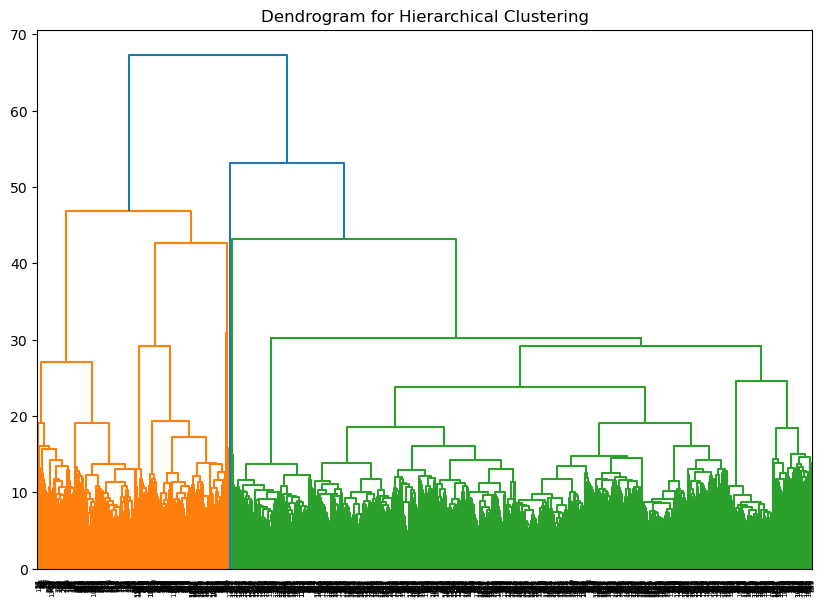

/Users/nishkagovil/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_agglomerative.py:1005: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


Cluster Sizes: {0: 340, 1: 1028, 2: 1}


In [112]:
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering

linked = linkage(pca_dataframe.iloc[:, :-2], method='ward')
plt.figure(figsize=(10, 7))
dendrogram(linked)
plt.title('Dendrogram for Hierarchical Clustering')
plt.show()

cluster_model = AgglomerativeClustering(n_clusters=3, affinity='euclidean', linkage='ward')
labels = cluster_model.fit_predict(pca_dataframe.iloc[:, :-2])

unique, counts = np.unique(labels, return_counts=True)
print("Cluster Sizes:", dict(zip(unique, counts)))

## 3) Equal-size Spectral Clustering

In [113]:
## Source: https://towardsdatascience.com/equal-size-spectral-clustering-cce65c6f9ba3
## https://github.com/anamabo/Equal-Size-Spectral-Clustering/tree/main/source_code 

In [114]:
import spectral_equal_size_clustering
import visualisation

clustering = spectral_equal_size_clustering.SpectralEqualSizeClustering(nclusters=100,
                                         nneighbors=13,
                                         equity_fraction=0.9,
                                         seed=1234
                                         )

In [115]:
from scipy.spatial.distance import pdist, squareform
distance_matrix = squareform(pdist(pca_dataframe.iloc[:, :-2], metric='euclidean'))

In [116]:
labels = clustering.fit(distance_matrix)

INFO:root:parameters of the cluster: nclusters: (100,) equity_fr: 0.9 nneighbours: 13
/Users/nishkagovil/anaconda3/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1872: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
INFO:root:ideal elements per cluster: [14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13]
INFO:root:min-max range of elements: 11.700000000000001-15.400000000000002
/Users/nishkagovil/Downloads/TV show project/spectral_equal_size_clustering.py:196: RuntimeWarning: Mean of empty slice.
  dist = {c: dmatrix[idxc[c], point].mean() for c in clusters_to_modify}  # 

In [117]:
pca_dataframe['ESSC Cluster'] = labels

In [118]:
pca_dataframe

0         1         2         3         4         5         6  \
0     1.365369  1.762218 -0.627544  0.352281  1.243590  0.467553 -0.358386   
1     5.959942 -3.862954  0.541224 -0.071045  0.276685 -0.276207  1.046035   
2     6.015511 -2.870793 -0.434276 -0.019319 -1.530472  0.015258  0.176710   
3     4.441979 -4.446284 -0.587520  0.194435 -0.684003 -1.409462  0.541776   
4     5.090815 -4.147194 -0.268693  0.059851 -0.059756  0.455643  0.517244   
...        ...       ...       ...       ...       ...       ...       ...   
1364 -1.048340  0.114879  0.085440  0.044894  0.194042 -0.649293 -0.679247   
1365 -1.108481  0.411101 -0.987105  0.333782 -0.357475  0.879930  0.715351   
1366 -1.298885  0.480620  0.419400 -0.471731  0.396977 -0.836530 -0.276257   
1367 -1.156925 -0.212803  0.783391 -0.153460  0.060680  0.252594 -1.273474   
1368 -0.548318  0.447653 -0.030864 -0.014131 -0.350286  0.304433 -0.320967   

             7         8         9        10        11        12        13  \
0     0.219371 -0.544108  0.755759  0.348644  1.236083  0.087511 -1.126533   
1     1.166897  0.288267  0.002220 -0.137479 -0.331929 -0.553135 -0.213904   
2     0.972745 -0.629992  1.433243  1.088873 -1.221475  1.721972 -0.108032   
3     1.138159 -0.112862  0.237731 -0.010581 -1.247977  1.080919 -0.057858   
4    -0.255902  0.618019 -0.291339  0.582741  0.059380  1.587310  0.265398   
...        ...       ...       ...       ...       ...       ...       ...   
1364 -0.188233  0.188957 -0.803913 -0.347590  0.034511 -0.154312 -0.396467   
1365 -0.440986  0.276416  0.199642 -0.976397  0.735492  1.319436  0.975493   
1366  0.535268  1.213179 -0.933214  0.628024 -0.782875  0.543541  0.283644   
1367  0.141690 -0.209939 -0.672767  0.031853  0.172969  0.128777  0.015889   
1368 -0.195063  0.006624 -0.415466 -0.500435  0.387858 -0.154814 -0.418330   

            14        15        16        17        18        19        20  \
0    -0.364079 -0.214976  0.092139 -0.182824 -0.023212  0.124095  0.497854   
1     0.877752  0.709536  0.364551  0.912827 -0.091258 -0.607196 -0.452960   
2    -0.153857 -0.204100 -0.151616 -0.009958  0.142641 -0.647794  0.244012   
3    -0.114534  0.343602 -0.641911  0.258447  0.355172 -0.360747 -0.173904   
4    -1.383124 -0.659464 -0.609861 -0.527937 -0.408338 -0.077446  0.737570   
...        ...       ...       ...       ...       ...       ...       ...   
1364 -0.239482  0.571550 -0.730768  0.213643  1.006566 -0.315368 -0.270263   
1365 -0.429049  0.682403  0.120765 -0.493594  0.700624  0.214226  0.542525   
1366  0.168746 -0.023941 -0.405459 -0.508147  0.430290  0.268936 -0.207301   
1367  0.494718 -0.613485 -0.465970 -0.168446  0.188568 -0.362682  0.333170   
1368  0.280055  0.201430 -0.461197 -1.045777  0.081688  0.068825  1.194501   

            21        22        23        24        25        26        27  \
0     0.557203  0.291069  0.513290  0.408618  0.031400 -0.792248  0.837227   
1    -0.335708 -0.246718  0.089104  0.321710  0.606532  0.003101 -0.031294   
2     0.223438 -0.234378  0.097665 -0.263149 -0.503712  0.680847  0.568827   
3     0.021830 -0.227384  0.310233  0.237910 -0.018507  0.392813  0.199967   
4     0.649723  0.570899 -0.136505  0.210210  0.590281  0.288599  0.897453   
...        ...       ...       ...       ...       ...       ...       ...   
1364 -0.295773  0.033415 -0.526296  0.385234  0.125436  0.446412  0.445567   
1365  0.552962 -0.762477 -0.398878 -0.073334  0.099043  0.099078 -0.620747   
1366  0.044962 -0.164405 -0.248689 -0.005200 -0.276419 -0.066073  0.150068   
1367  0.942729  0.224599 -0.199429 -0.526387  0.352212 -0.240681 -0.350429   
1368 -0.171445 -0.575100  0.805581 -0.098308  0.780289 -0.578942 -0.788128   

            28        29        30        31        32        33        34  \
0     0.002106  0.182129 -0.011356  0.044794 -0.756362  0.393836  0.602287   
1    -0.459678  0.885485 -0.273279  0.081463  0.318459 -0.304939  0.156112   
2     0.037223 -0.085511  0.215

In [119]:
## Check if the clusters are relatively equal-sized. For the most part, they are. 

pca_dataframe['ESSC Cluster'].value_counts()

ESSC Cluster
72    23
69    22
31    22
27    21
39    20
      ..
97     8
80     7
99     7
50     4
71     1
Name: count, Length: 98, dtype: int64

In [120]:
cluster = pca_dataframe[pca_dataframe['Title'] == "Gossip Girl"]['ESSC Cluster']
int(cluster.iloc[0])

68

In [121]:
pca_dataframe[pca_dataframe['ESSC Cluster'] == 28]

0         1         2         3         4         5         6  \
214  -1.250511  0.054955  0.033657  0.278310  0.046125 -0.101772 -1.167869   
416  -1.054213 -0.020718  1.101197 -0.320853 -0.378108 -0.300545 -1.269482   
443  -1.142550 -0.348003  0.619409 -0.031608  0.336343  0.866897 -1.164018   
557  -0.997341  0.104694  1.148927 -0.378226 -0.716641  0.259685 -1.903819   
578  -1.241037  0.057958  1.109799 -0.329714 -0.095676 -0.493520 -1.567989   
603  -0.996744  0.014531  0.843117 -0.267473 -0.351311  0.214690 -1.912932   
919  -1.445973  0.429512  0.833701 -0.227469 -0.362329 -0.414865 -1.360761   
1229 -1.029574 -0.180840  1.375848 -0.337131 -0.235585 -0.513045 -1.300919   
1276 -0.970064 -0.307091  0.848831 -0.221196 -0.081707 -0.058972 -1.226987   

             7         8         9        10        11        12        13  \
214   0.924853 -0.203239  0.144664 -0.394556  0.247841  0.010789  0.280620   
416   0.601017 -0.421034  0.144884  0.414423  0.430394 -0.181101  0.819187   
443   0.680757 -0.455608 -0.089331  0.272090  0.062474 -0.708614  0.647318   
557   0.308471 -0.332994  1.216776  0.745733  0.227583  0.550273  0.063762   
578   0.549853 -0.232318  0.638365 -0.496933  0.053095  0.258882  0.434104   
603   0.339380 -0.329404  0.878217  0.422308  0.070323 -0.367144  0.977132   
919   1.148583 -0.977453  0.159818  0.402233 -0.182624 -0.195142  0.359603   
1229  0.413188 -0.354676  0.812265  0.454706  0.260547  0.449421  0.400257   
1276  0.667908 -0.056461  0.417274  0.349117  1.066331  0.141926  0.463035   

            14        15        16        17        18        19        20  \
214  -0.010042 -0.175529 -0.071367  0.136578  0.785354  0.312861 -0.639032   
416  -0.144140  0.868271 -0.066864 -0.353301 -0.326373 -0.122111  0.378070   
443  -0.580837  0.728875 -0.454219 -0.868764  0.122896  0.468394 -1.133903   
557   0.567349 -0.201745  0.225269 -0.403723  0.059200 -0.537441  0.485519   
578   0.513573  0.047630 -0.347858  0.105923 -0.100617  0.233073  0.155463   
603   0.133731 -0.321250  0.641102  0.227010  0.931738  0.955028 -0.032397   
919   0.021637  0.583884  0.079312  0.386214 -0.277746 -0.316400  0.126661   
1229  0.579016 -0.017494 -0.532229 -0.343790 -0.016175 -0.041148 -0.165097   
1276  0.580625 -0.575378 -0.485591 -0.197974  0.537860  0.883099  0.077276   

            21        22        23        24        25        26        27  \
214  -0.491100 -0.047382 -0.220094  0.247998  0.003718  0.562209 -0.284612   
416   0.224506  0.272313 -0.350878 -0.095621  0.223949 -0.000389 -0.590215   
443  -0.102840 -0.033553 -0.619612  0.875459 -0.538735  0.277256  0.293623   
557  -0.205778  0.254755  0.544828  0.080199  0.418242  0.467459  0.433646   
578   0.102711  0.402585 -0.165372  0.358941  0.607372  0.304909 -0.773341   
603   0.655271  0.441608 -0.088125 -0.177458 -0.288701  0.240077 -0.246391   
919  -0.513625  0.052675  0.084480  0.351958  0.537374  0.803714 -0.008230   
1229 -0.269495  0.359620  0.145188 -0.068788 -0.031632 -0.002565  0.118475   
1276  0.633772  0.288325 -0.906275 -0.169352 -0.128765 -0.115340 -0.299637   

            28        29        30        31        32        33        34  \
214  -1.013685  0.233918  0.157657 -0.387604  0.210183 -0.301165  0.307922   
416  -0.446012  0.704591 -0.108410  0.288487  0.259814  0.078671  0.661481   
443  -0.638262  1.553279  0.072831  0.042184  0.231369  0.037860  0.337760   
557  -0.475941  0.607241  0.235564  0.619189  0.643155 -0.196895 -0.188873   
578  -0.746489  0.657216  0.244744  0.036001 -0.107469 -0.229512  0.292714   
603  -0.786102  0.904623  1.307966  0.501452 -0.217894 -0.351637 -0.209077   
919  -0.333935  0.757809  0.407548 -0.277457 -0.343435  0.554645 -0.330839   
1229 -0.408152  0.336300 -0.158190  0.137971  0.392399 -0.089862  0.183324   
1276 -0.694027  0.974018 -0.004057  0.293408  0.302734 -0.153051  0.349615   

            35        36        37        38        39        40        41  \
214   0.155395  0.417832 -0.16

# Create the final recommendation function to predict similar tv shows

In [122]:
import difflib

def find_similar_shows(title):
    if title in pca_dataframe['Title'].values:
        cluster = pca_dataframe[pca_dataframe['Title'] == title]['ESSC Cluster']
        cluster_int = int(cluster.iloc[0])
        print(pca_dataframe[pca_dataframe['ESSC Cluster'] == cluster_int]['Title'])
    else:
        column_values = pca_dataframe['Title'].tolist()
        closest_match = difflib.get_close_matches(title, column_values, n=1)
        if closest_match:
            cluster = pca_dataframe[pca_dataframe['Title'] == closest_match[0]]['ESSC Cluster']
            cluster_int = int(cluster.iloc[0])
            print(pca_dataframe[pca_dataframe['ESSC Cluster'] == cluster_int]['Title'])
        else:
            print("Sorry, this show is not in our database.")

In [123]:
find_similar_shows('Scandal')

141    Saved by the Bell
146           Parenthood
193           Millennium
201                   Oz
219         Will & Grace
221     Sex and the City
251               Titans
269           The Shield
377          Burn Notice
380          The Killing
445           Flashpoint
476             Leverage
623              Scandal
676            Justified
746           Perception
758             Homeland
Name: Title, dtype: object
